In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp
from scipy.signal import find_peaks
from tqdm import tqdm

In [2]:
# defining parameters from Krishna/Jensen

k_Nin = 5.4 # min^{-1}
k_lin = 0.018 # min^{-1} 
k_t = 1.03 # mu * M^{-1} * min^{-1}
k_tl = 0.24 # min^{-1}
K_I = 0.035 # mu * M
K_N = 0.029 # mu * M
gamma_m = 0.017 # min^{-1}
alpha = 1.05 # mu * M^{-1} * min^{-1}
N_tot = 1.0 # mu * M
k_a = 0.24 # min^{-1}
k_i = 0.18 # min^{-1}
k_p = 0.036 # min^{-1}
k_A20 = 0.0018 # mu * M
IKK_tot = 2.0 # mu * M
A20 = 0.0026 # mu * M

In [3]:
# defining time
time = (0, 5000)

# defining constant to keep TNF>0
k = 0.5

# definerer startparameters
N_n0, I_m0, I0, IKK_a0, IKK_i0, TNF_k = 1, 0.5, 0.5, 0.5, 0.5, k
y0 = [N_n0, I_m0, I0, IKK_a0, IKK_i0, TNF_k]

In [4]:
# defining omega, number of oscillations, amplitude, TNF_0 and start parameters as the last values of the first simulation
omega = 1
no_osc = 50
Amp1 = 0.24
T_intt = 108.44444444444444
A_intt = 0.1293511878383227
p0 = [0.037770776771579556, 0.4050017925580332, 4.076546559955566, 0.1799999999999995, 1.5500000000000012]

T_extt = omega * T_intt

In [5]:
# defining equations from Krishna/Jensen
def N_n_change(t, N_n, I_m, I, IKK_a, IKK_i, TNF):
    dN_ndt = k_Nin * (N_tot - N_n) * K_I / (K_I + I) - k_lin * I * (N_n / (K_N + N_n))
    return dN_ndt

def I_m_change(t, N_n, I_m, I, IKK_a, IKK_i, TNF):
    dI_mdt = k_t * (N_n**2) - gamma_m * I_m
    return dI_mdt

def I_change(t, N_n, I_m, I, IKK_a, IKK_i, TNF):
    dIdt = k_tl * I_m - alpha * IKK_a * (N_tot - N_n) * I / (K_I + I)
    return dIdt

def IKK_a_change(t, N_n, I_m, I, IKK_a, IKK_i, TNF):
    dIKK_adt = k_a * TNF * (IKK_tot - IKK_a - IKK_i) - k_i * IKK_a
    return dIKK_adt

def IKK_i_change(t, N_n, I_m, I, IKK_a, IKK_i, TNF):
    dIKK_idt = k_i * IKK_a - k_p * IKK_i * k_A20 / (k_A20 + A20 * TNF)
    return dIKK_idt

def system_nfkb(t, y, Amp_new):
    # Extract current state variables, assume TNF is not part of y here
    N_n, I_m, I, IKK_a, IKK_i = y
    # Dynamically compute TNF based on current time t (this means it will be a constant passed to the next equations for this dt)
    TNF = k + Amp_new * np.sin(np.pi * (1 / T_extt) * t*2*np.pi)
    # calling differential equation functions, passing TNF as an argument
    # Updating function definitions accordingly if they require TNF
    return [N_n_change(t, *y, TNF), 
            I_m_change(t, *y, TNF), 
            I_change(t, *y, TNF), 
            IKK_a_change(t, *y, TNF), 
            IKK_i_change(t, *y, TNF)]

In [6]:
# defining function to oscillate TNF (sinusoidal)
def TNF_sin_osc(oscillations, Amp):

    history = {"t":[] ,"N_n": [], "I_m": [], "I": [], "IKK_a":[], "IKK_i":[], "TNF":[]}

    
    for i in tqdm(range(oscillations)):
        if i == 0:
            state = p0
        else:
            state = history["N_n"][-1], history["I_m"][-1], history["I"][-1], history["IKK_a"][-1], history["IKK_i"][-1]

        sys = solve_ivp(system_nfkb, (0, T_extt), state, args=(Amp,), method='RK45', max_step=0.1, dense_output=True) # Is this step size too low?
        
        N_n, I_m, I, IKK_a, IKK_i = sys["y"][0], sys["y"][1], sys["y"][2], sys["y"][3], sys["y"][4]

        new_t = np.array(sys["t"]) + (history["t"][-1] if history["t"] else 0)
        history["t"].extend(new_t)
        history["N_n"].extend(N_n)
        history["I_m"].extend(I_m)
        history["I"].extend(I)
        history["IKK_a"].extend(IKK_a)
        history["IKK_i"].extend(IKK_i)
        history["TNF"].extend(k + Amp * np.sin(np.pi * (1 / T_extt) * new_t))

    return history

In [9]:
# why does the amplitude og NFKB keep changing?
def multi_amplitude_plot(A_min, A_max, stepsize):
    
    Amp_arr = np.linspace(A_min, A_max, stepsize)

    all_sim = {"t":[] ,"N_n": [], "I_m": [], "I": [], "IKK_a":[], "IKK_i":[], "TNF":[]}

    for i in range(stepsize):
        TNF_simi = TNF_sin_osc(no_osc, Amp_arr[i])
        all_sim["t"].append(TNF_simi["t"])
        all_sim["N_n"].append(TNF_simi["N_n"])
        all_sim["I_m"].append(TNF_simi["I_m"])
        all_sim["I"].append(TNF_simi["I"])
        all_sim["IKK_a"].append(TNF_simi["IKK_a"])
        all_sim["IKK_i"].append(TNF_simi["IKK_i"])
        all_sim["IKK_i"].append(TNF_simi["IKK_i"])
    return all_sim, Amp_arr

In [10]:
A_min = 0.2
A_max = 0.225
stepsize = 5

sims, Amp_arr = multi_amplitude_plot(A_min, A_max, stepsize)

100%|██████████| 50/50 [00:07<00:00,  6.49it/s]


In [11]:
print(sims)

{'t': [[0.0, 0.1, 0.2, 0.30000000000000004, 0.4, 0.5, 0.6, 0.7, 0.7999999999999999, 0.8999999999999999, 0.9999999999999999, 1.0999999999999999, 1.2, 1.3, 1.4000000000000001, 1.5000000000000002, 1.6000000000000003, 1.7000000000000004, 1.8000000000000005, 1.9000000000000006, 2.0000000000000004, 2.1000000000000005, 2.2000000000000006, 2.3000000000000007, 2.400000000000001, 2.500000000000001, 2.600000000000001, 2.700000000000001, 2.800000000000001, 2.9000000000000012, 3.0000000000000013, 3.1000000000000014, 3.2000000000000015, 3.3000000000000016, 3.4000000000000017, 3.5000000000000018, 3.600000000000002, 3.700000000000002, 3.800000000000002, 3.900000000000002, 4.000000000000002, 4.100000000000001, 4.200000000000001, 4.300000000000001, 4.4, 4.5, 4.6, 4.699999999999999, 4.799999999999999, 4.899999999999999, 4.999999999999998, 5.099999999999998, 5.1999999999999975, 5.299999999999997, 5.399999999999997, 5.4999999999999964, 5.599999999999996, 5.699999999999996, 5.799999999999995, 5.899999999999

In [17]:
t1, N_n1, I_m1, I1, IKK_a1, IKK_i1, TNF1 = np.array(sims["t"]), np.array(sims["N_n"]), np.array(sims["I_m"]), np.array(sims["I"]), np.array(sims["IKK_a"]), np.array(sims["IKK_i"]), np.array(sims["TNF"])

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


IndexError: index 0 is out of bounds for axis 0 with size 0

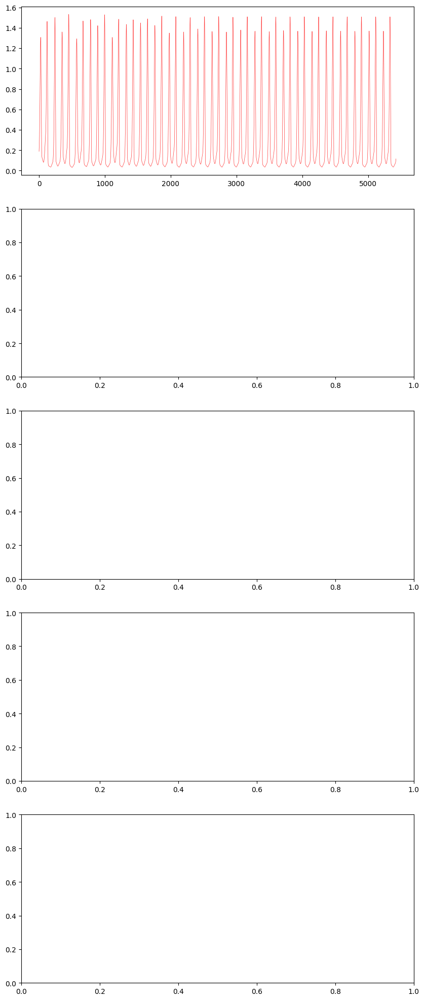

In [18]:
figure, axis = plt.subplots(stepsize, figsize=[10,stepsize*5])
x=5
for i in tqdm(range(stepsize)):
        axis[i].plot(t1[i], x*N_n1[i], color="#FF0000", alpha=0.8, lw=0.5, label = f'{x}x  NF$\kappa$B')
        axis[i].plot(t1[i], TNF1[i], alpha=1, color="#03FF00", lw=0.5, label = f'TNF with T = {T_extt[i]:.4}, A = {Amp_arr[i]}')
        axis[i].set_title(rf'(Sim. Nr.: {i}) Sinusoidal oscillation: $\Omega$ = {omega}/1, A={Amp_arr[i]}')
        axis[i].legend();  
for ax in axis.flat:
    ax.set(xlabel='time [min.]', ylabel='concentration')
for ax in axis.flat:
    ax.label_outer()

    plt.tight_layout()